# Simultaneous Separation and Segmentation in Layered Music

### Prem Seetharaman and Bryan Pardo, ISMIR 2016

This notebook presents the separation/segmentation algorithm presented in the following paper:

> http://music.cs.northwestern.edu/publications/seetharaman_pardo_ismir16.pdf

>Seetharaman, Prem, and Bryan Pardo. "Simultaneous separation and segmentation in layered music." Proc. of the 17th International Society for Music Information Retrieval Conference (ISMIR). New York City, NY, USA, 2016

## Background

### Source separation

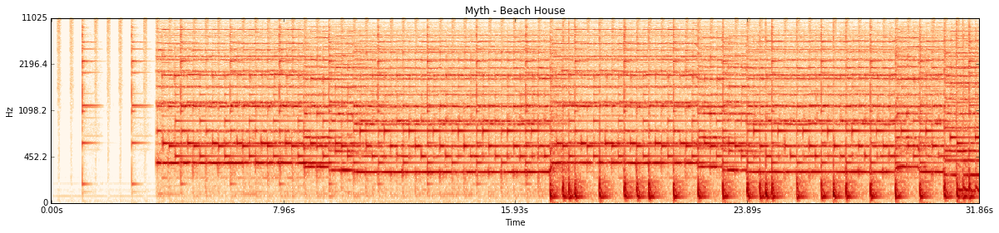

In [58]:
import librosa
from functions import *
from separate import *
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline
%reload_ext autoreload
%autoreload 2
audio_path = 'demo_songs/myth.mp3'
audio_signal, sr, audio_stft = load_file(audio_path)

display_spectrogram_and_audio(audio_stft, audio_signal, sr, 'Myth - Beach House')

The goal of source separation is to separate a mixture (such as the one above) into its constituent parts. What these parts are are defined by your perception of the mixture. Here's an example of source separation using one common technique - harmonic/percussive source separation [1].

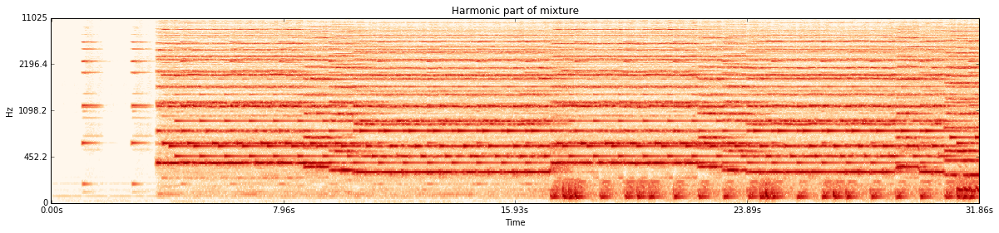

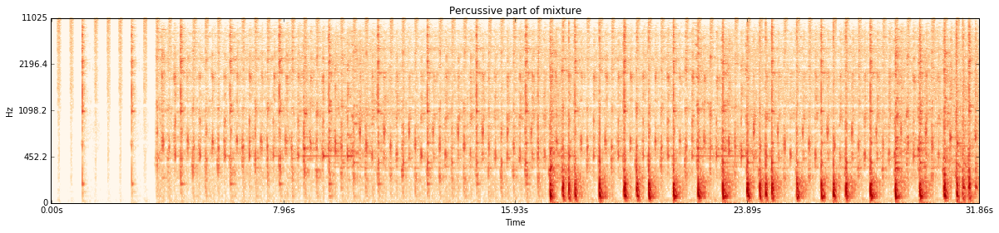

In [59]:
audio_hpss = zip(librosa.effects.hpss(audio_signal), ['Harmonic part of mixture', 'Percussive part of mixture'])
for a,t in audio_hpss:
    a_stft = librosa.stft(a)
    display_spectrogram_and_audio(a_stft, a, sr, t)

Source separation algorithms rely on different auditory cues. Harmonic/percussive source separation, as above, relies on the idea that percussive sources will be short in time but broad in frequency, and harmonic sources will be long in time and narrow in frequency. Separating vertical lines from horizontal lines in the spectrogram representation above leads to harmonic/percussive source separation. Other source separation approaches rely on other auditory cues.

## Non-negative matrix factorization

Nonnegative Matrix Factorization (NMF) is a popular source separation method. It learns a dictionary of spectral templates from the audio. Source separation with NMF requires something external to the NMF algorithm to group spectral templates by source. The spectral templates can be used to separate the associated sources from the mixture.

Let's look at the part of the above mixture where the "shk" sound is isolated:

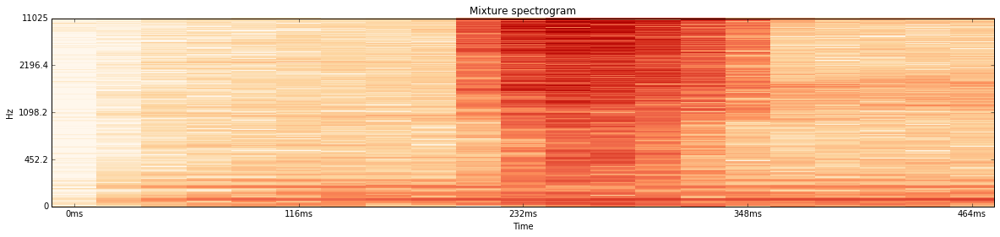

In [60]:
start = 0 #in seconds
stop = .5
boundaries = [int(x) for x in librosa.samples_to_frames([start*sr, stop*sr])]

display_spectrogram_and_audio(audio_stft[:, boundaries[0]:boundaries[1]], 
                              audio_signal[int(sr*start):int(sr*stop)], 
                              sr, 
                              'Mixture spectrogram')

The percussive noise burst can be seen in the spectrogram above. It's that wide-band energy between 232ms and 358ms. Let's build a source model of this percussive noise burst using NMF:

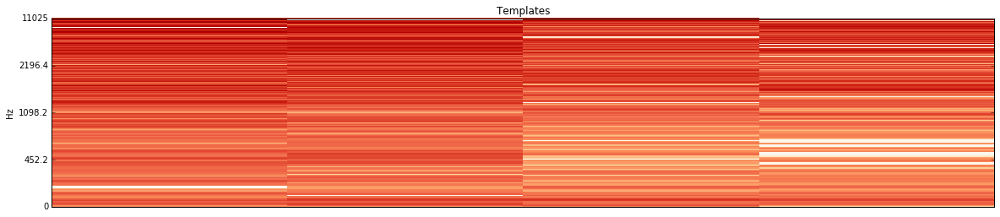

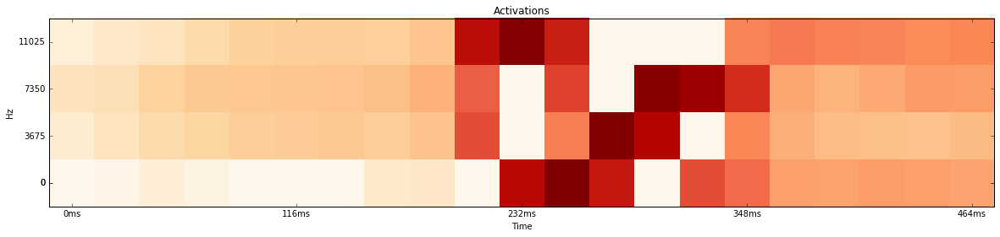

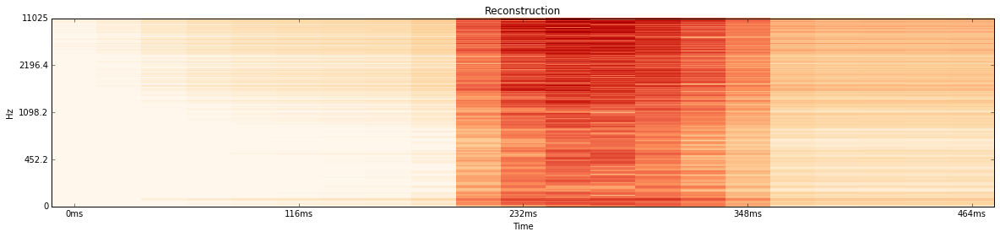

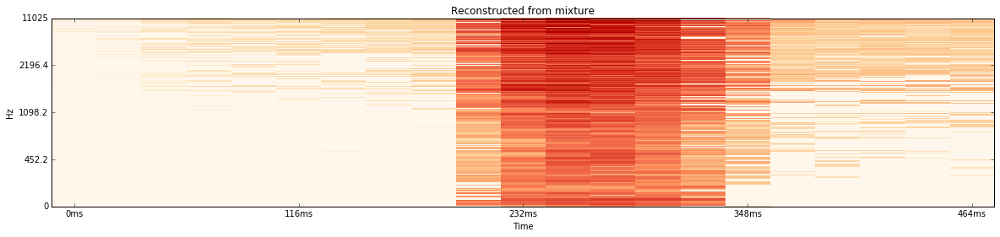

In [61]:
templates, activations = find_template(audio_stft, sr, 4, 4+1, boundaries[0], boundaries[1])
display_spectrogram(templates, 'Templates', None, 'log')
display_spectrogram(activations, 'Activations', 'time', 'log')
display_spectrogram(templates.dot(activations), 'Reconstruction', 'time', 'log')
template, residual = extract_template(templates, audio_stft[:, boundaries[0]:boundaries[1]])
display_spectrogram_and_audio(template, librosa.istft(template), sr, 'Reconstructed from mixture')

The templates learned were as expected: broadband noise of varying widths. The noise bursts activate at the same time as in the original spectrogram. Multiplying the templates by the activations reconstructs the original spectrogram. Using the reconstruction as a mask on the original spectrogram (so we can keep the phase) gives us something we can invert back to the time domain to listen to.

We see that running NMF on a part of the mixture lets you reconstruct that one part of that mixture easily. *What happens if we try to reconstruct the entire mixture, using just the spectral templates learned from a single part?*

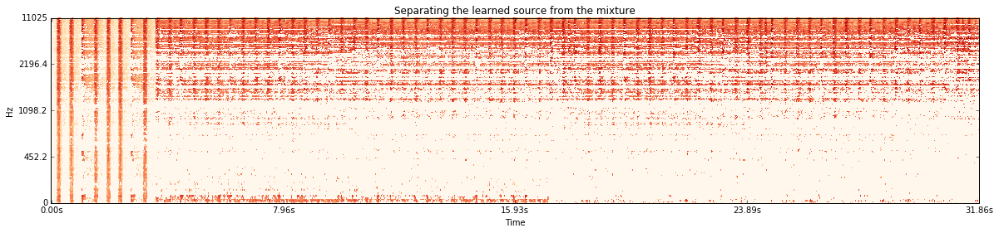

In [62]:
template, residual = extract_template(templates, audio_stft)
display_spectrogram_and_audio(template, librosa.istft(template), sr, 'Separating the learned source from the mixture')

It separated out just the noise burst from the entire mixture! What's the rest of it sound like?

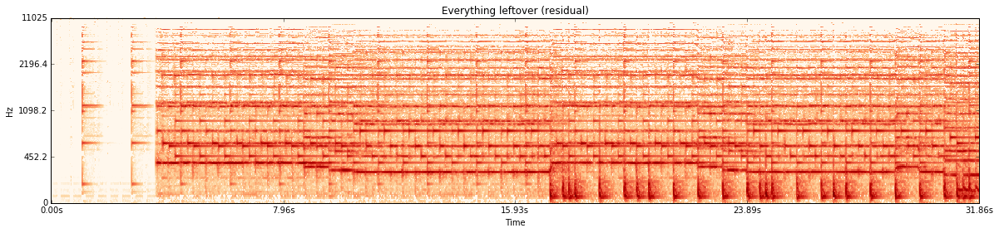

In [63]:
display_spectrogram_and_audio(residual, librosa.istft(residual), sr, 'Everything leftover (residual)')

NMF lets us use parts of the mixture to build an understanding of the entire mixture.

### Key idea: often, the composer will signal to the listener how the mixture should be listened to by introducing compositional elements (sources or groups of sources) in a sequential manner.

Let's look at and listen to some examples.

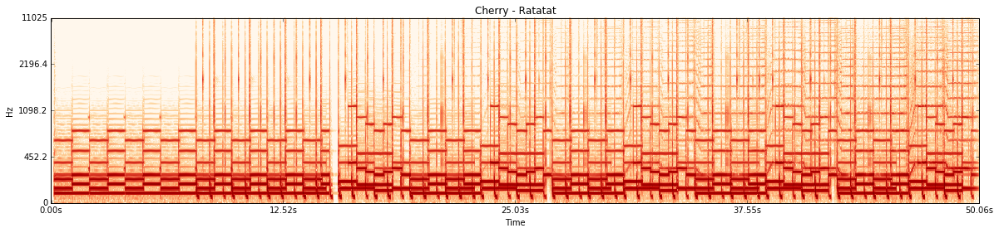

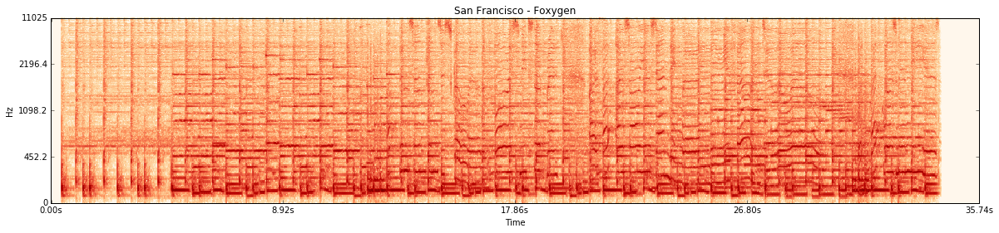

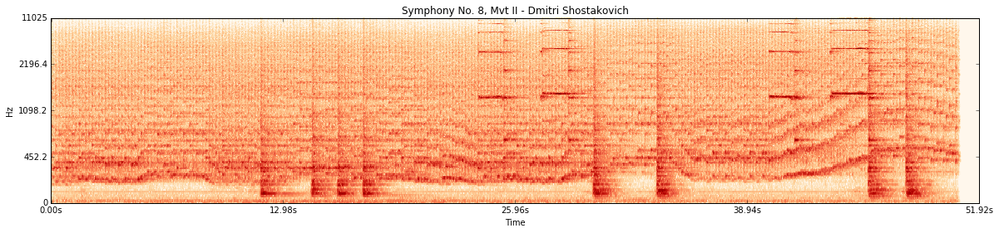

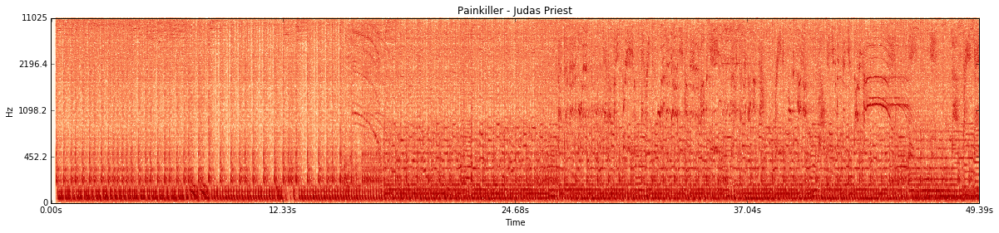

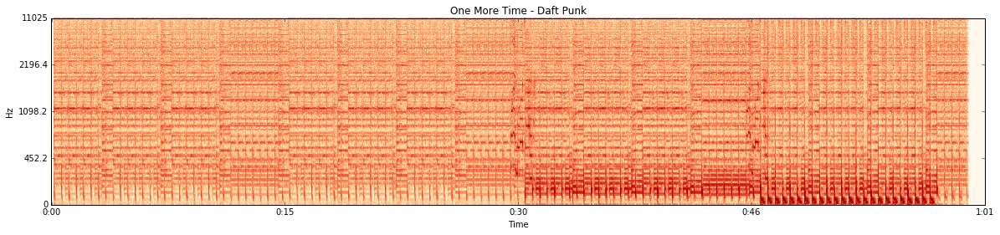

In [64]:
load_and_display('demo_songs/cherry.wav', 'Cherry - Ratatat')
load_and_display('demo_songs/sanfrancisco.wav', 'San Francisco - Foxygen')
load_and_display('demo_songs/shosty8.wav', 'Symphony No. 8, Mvt II - Dmitri Shostakovich')
load_and_display('demo_songs/painkiller.wav', 'Painkiller - Judas Priest')
load_and_display('demo_songs/onemoretime.wav', 'One More Time - Daft Punk')

In each of these, the source groups are introduced one by one. This behavior can be seen in the spectrogram as well as heard. **Our work detects and leverages this "layering" structure to guide source separation.**

## Our approach

The key idea behind our work is to find the boundary point when a new layer come in, learn a source model using non-negative matrix factorization for the segment leading up to the boundary point, and extract the source from the mixture. We iterate the algorithm on the residual mixture.

Our approach has 4 steps: 

1. Estimation
2. Segmentation
3. Modelling
4. Separation

We now detail each of these stages.

### Estimation

We first split the spectrogram into bigger windows. To do this, we use the beat-tracker from LibROSA [2].

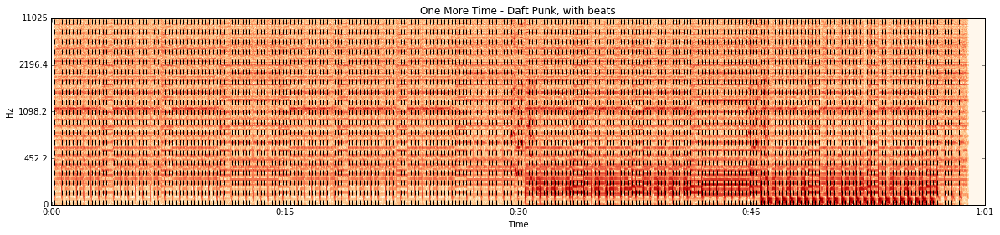

In [65]:
audio_signal, sr, audio_stft = load_file('demo_songs/onemoretime.wav')
audio_stft, beats = segment_into_beats(audio_signal, sr)
beats = [int(b) for b in beats]
display_spectrogram(audio_stft, 'One More Time - Daft Punk, with beats', 'time', 'log', beats)
audio_signal_with_beats = np.copy(audio_signal)
beat_samples = librosa.frames_to_samples(beats)
audio_signal_with_beats[beat_samples] = 1
audio(audio_signal_with_beats, sr)

In the estimation step, we learn a model from a small portion of the beginning of the spectrogram - the first 4 beats. Then we track the reconstruction error of the source model for every beat in the mixture.

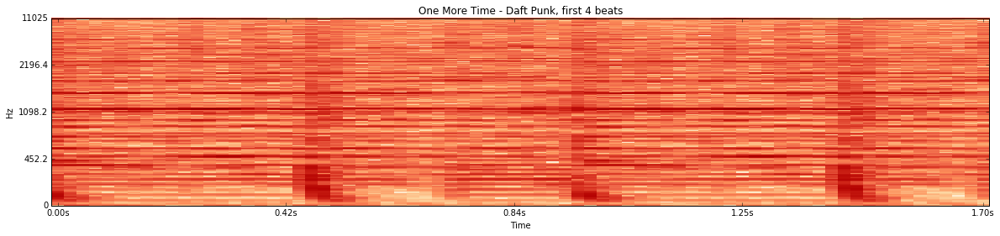

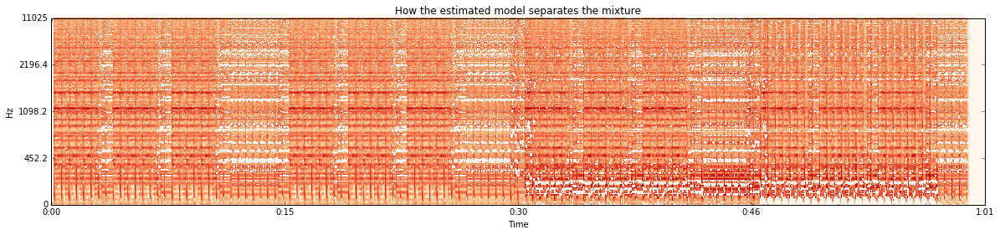

In [66]:
display_spectrogram_and_audio(audio_stft[:, int(beats[0]):int(beats[7])], 
                              audio_signal[int(beat_samples[0]):int(beat_samples[7])], 
                              sr, 
                              'One More Time - Daft Punk, first 4 beats')

templates, activations = find_template(audio_stft, sr, 8, 8+1, beats[0], beats[7])
template, residual = extract_template(templates, audio_stft)
display_spectrogram_and_audio(template, librosa.istft(template), sr, 'How the estimated model separates the mixture')

As we can see, when the voice and drums enter the mixture, the reconstruction begins to audibly fail since the model for the opening source group of the song cannot model the voice/drum source group. This leads us to the next step: segmentation.

### Segmentation

We identify these failure points by using beat-synchronous reconstruction error of the source model.

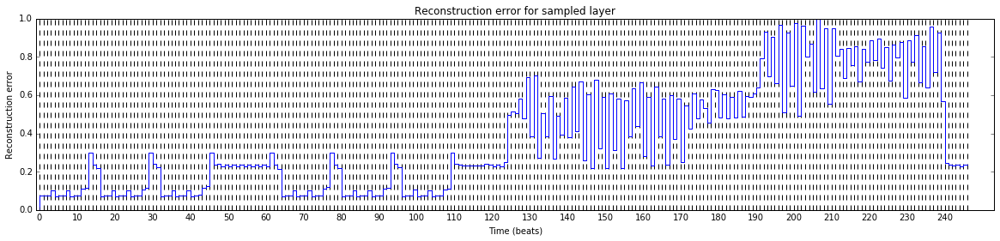

In [67]:
errors = beat_sync_error(audio_stft, beats, sr, n_components = 8)
show_errors(errors, beats, 'Reconstruction error for sampled layer')

We see that reconstruction error spikes most noticeably at beat 124, where the voice enters. We identify reconstruction error spikes using a method based on the moving median absolute deviation, as follows:

In [68]:
parameters = {'p': 5.5, 'q': .25, 'lag': 16}

def find_inflection_point(errors, beats, music_stft, start, parameters):
    errors = np.square(errors)
    max_diff = np.max(np.abs(np.diff(errors, n=1)))
    lag = parameters['lag']
    p = parameters['p']
    q = parameters['q']
    candidates = []
    d = lag
    while d < len(errors):
        window = errors[d-lag:d-1]
        if np.abs(errors[d] - np.median(window)) > p*mad(window) and np.abs(errors[d] - errors[d-1]) > q*max_diff:
            candidates.append(d)
            d = d + lag
        else:
            d = d + 1
    if not candidates:
        candidates = [len(errors) - 1]
    peak = candidates[0]
    return beats[peak] - 4, peak + start, candidates

In [69]:
spike = find_inflection_point(errors, beats, audio_stft, 0, parameters)[1]
print 'Found reconstruction error spike at: ' + str(spike)

Found reconstruction error spike at: 124


It found the 124th beat, which is the location of the spike above. We now learn a full model from beats 0 to 124:

### Modelling and separation

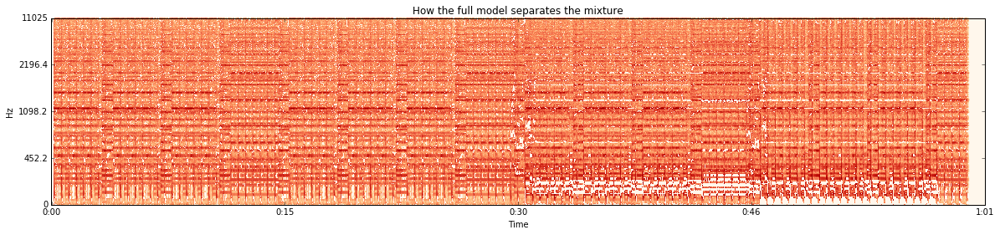

In [70]:
templates, activations = find_template(audio_stft, sr, 4, 4+1, beats[0], beats[spike])
template, residual = extract_template(templates, audio_stft)
display_spectrogram_and_audio(template, librosa.istft(template), sr, 'How the full model separates the mixture')

We can now look at reconstruction error again, this time for the full model:

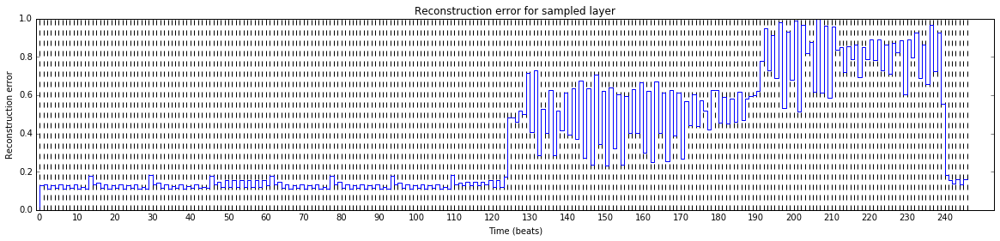

In [71]:
errors = get_template_error(audio_stft, beats, templates)
show_errors(errors, beats, 'Reconstruction error for sampled layer')

We see that the reconstruction error is now very low for everything up until beat 124. We can now iterate on the residual mixture:

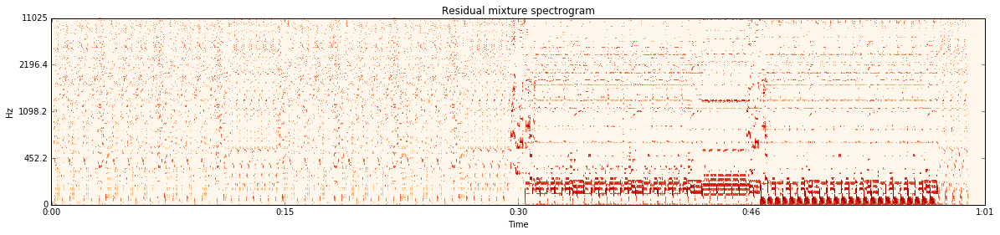

In [72]:
display_spectrogram_and_audio(residual, librosa.istft(residual), sr, 'Residual mixture spectrogram')

### Rinse and repeat until the mixture is empty, or no more segments can be found!

Here's the algorithm in full:

Going from beat 0 to 124
LAYER: 1
Going from beat 124 to 192
LAYER: 2
Going from beat 192 to 245
LAYER: 3
Went to end of file, terminating


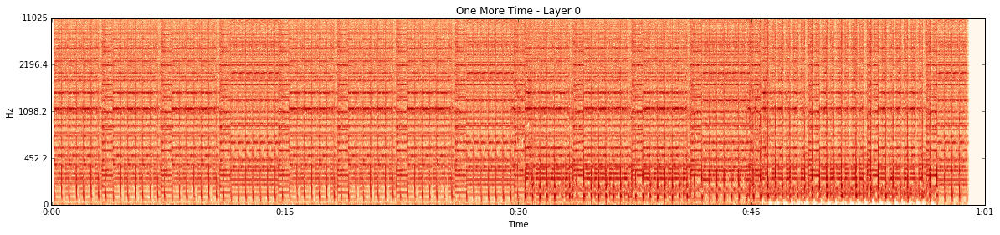

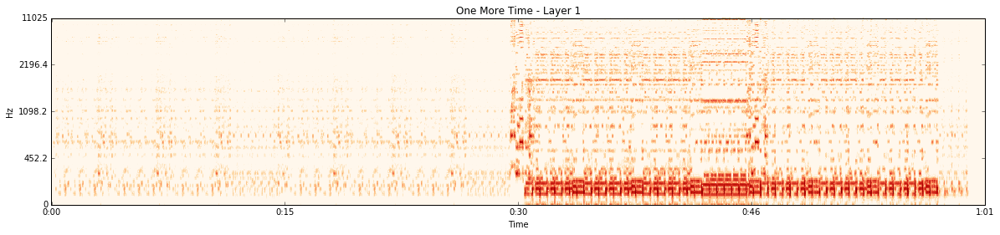

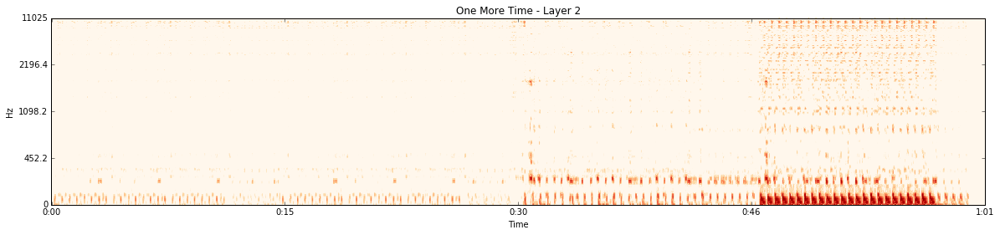

In [100]:
layers, boundaries, audio_stft = extract_all_layers('demo_songs/onemoretime.wav', n_components = 12)
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    if i == 2:
        l = layers[i]
        for k in range(i+1, len(layers)):
            l += layers[k]
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'One More Time - Layer ' + str(i))
    if i == 2:
        break

## More examples

Going from beat 0 to 16
LAYER: 1
Going from beat 16 to 79
LAYER: 2
Going from beat 79 to 143
LAYER: 3
Went to end of file, terminating


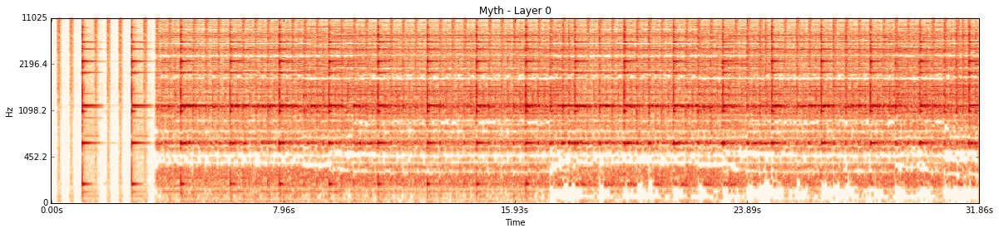

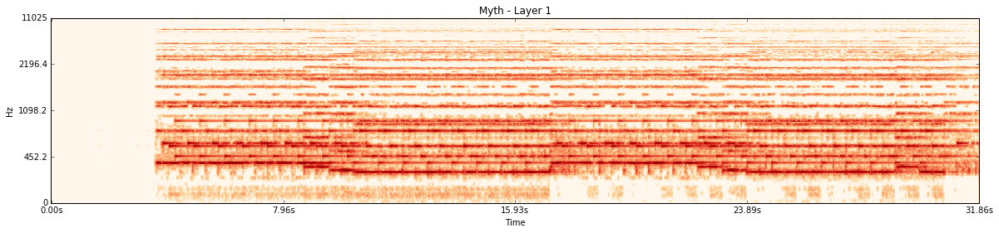

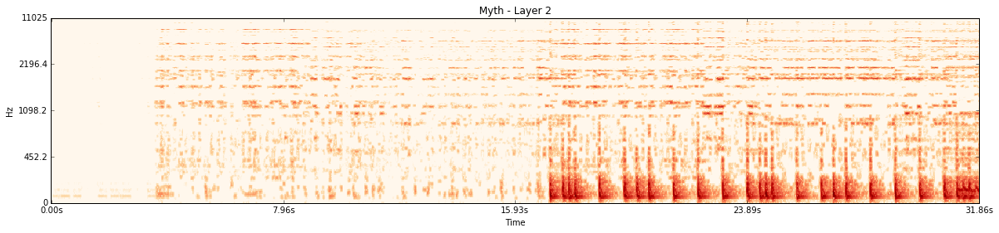

In [89]:
parameters = {'p': 7, 'q': .4, 'lag': 16}
layers, boundaries, audio_stft = extract_all_layers('demo_songs/myth.mp3', parameters)
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'Myth - Layer ' + str(i))

Going from beat 0 to 27
LAYER: 1
Going from beat 27 to 44
LAYER: 2
Going from beat 44 to 65
LAYER: 3
Residual rms too low, terminating


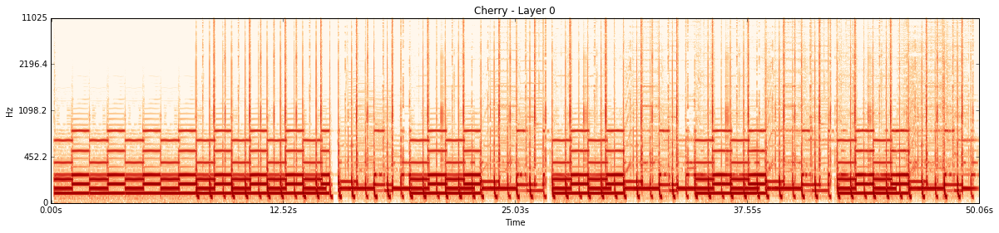

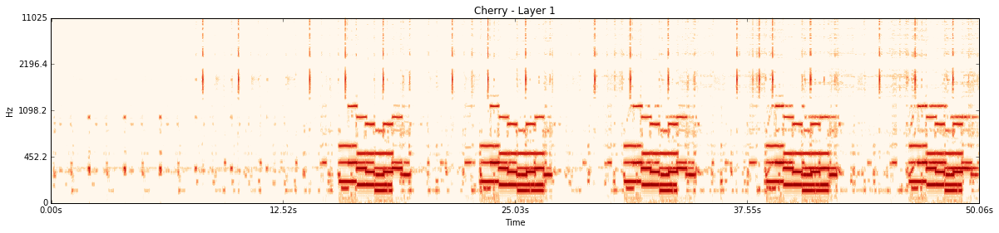

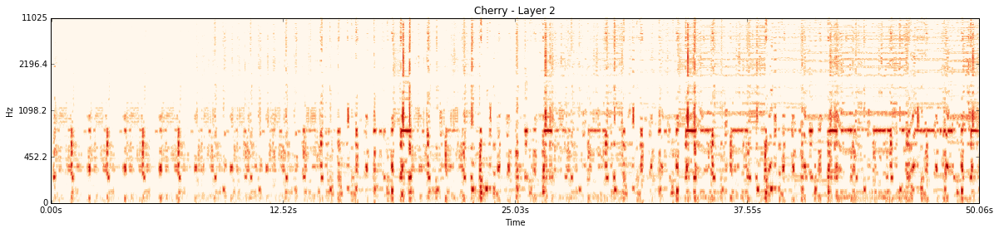

In [90]:
parameters = {'p': 5.5, 'q': .1, 'lag': 16}
layers, boundaries, audio_stft = extract_all_layers('demo_songs/cherry.wav', parameters)
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'Cherry - Layer ' + str(i))

Going from beat 0 to 117
LAYER: 1
Going from beat 117 to 239
LAYER: 2
Going from beat 239 to 275
LAYER: 3
Going from beat 275 to 335
LAYER: 4
Going from beat 335 to 370
LAYER: 5
Going from beat 370 to 402
LAYER: 6
Going from beat 402 to 457
LAYER: 7
Going from beat 457 to 518
LAYER: 8
Residual rms too low, terminating


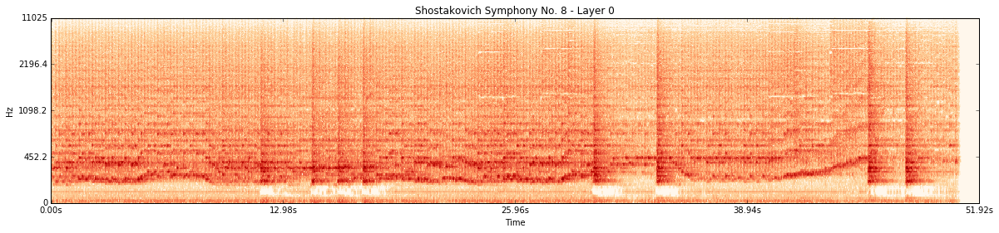

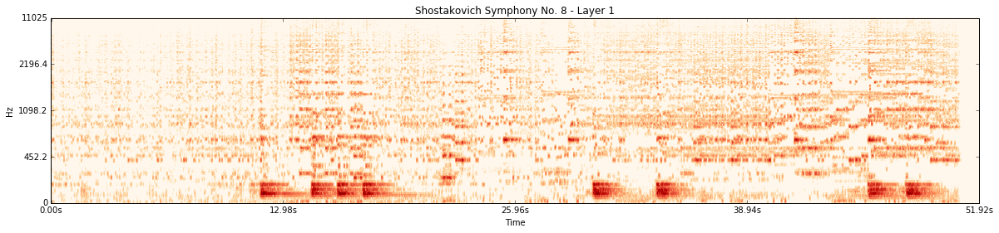

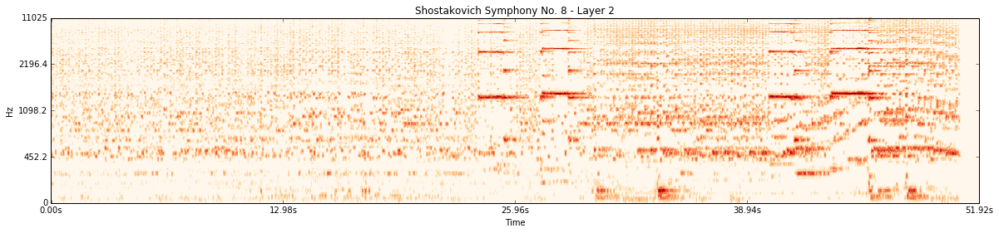

In [98]:
parameters = {'p': 6.5, 'q': .1, 'lag': 32}
layers, boundaries, audio_stft = extract_all_layers('demo_songs/shosty8.wav', parameters, beats = 'quantize', n_components = 12)
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    if i == 2:
        l = layers[i]
        for k in range(i+1, len(layers)):
            l += layers[k]
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'Shostakovich Symphony No. 8 - Layer ' + str(i))
    if i == 2:
        break

Going from beat 0 to 16
LAYER: 1
Going from beat 16 to 123
LAYER: 2
Went to end of file, terminating


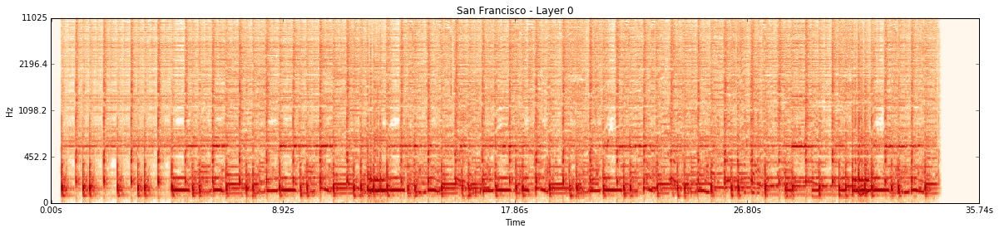

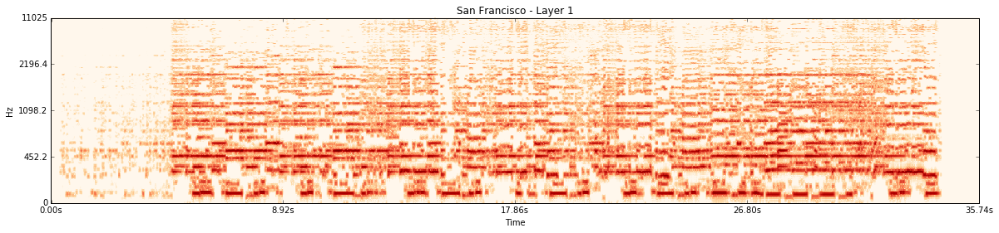

In [93]:
layers, boundaries, audio_stft = extract_all_layers('demo_songs/sanfrancisco.wav')
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'San Francisco - Layer ' + str(i))

Going from beat 0 to 24
LAYER: 1
Going from beat 24 to 96
LAYER: 2
Going from beat 96 to 121
LAYER: 3
Going from beat 121 to 149
LAYER: 4
Going from beat 149 to 163
LAYER: 5
Went to end of file, terminating


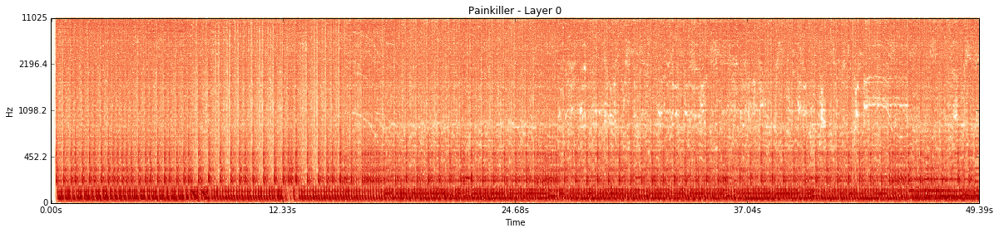

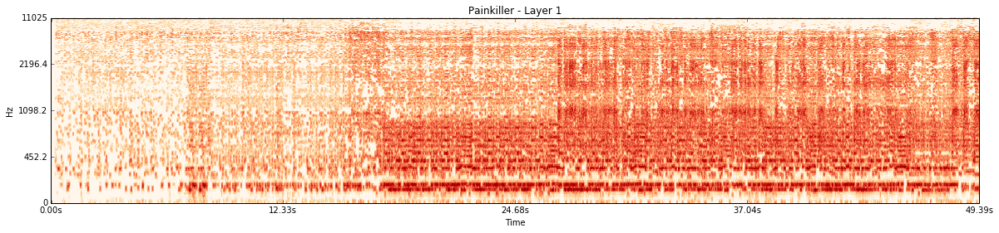

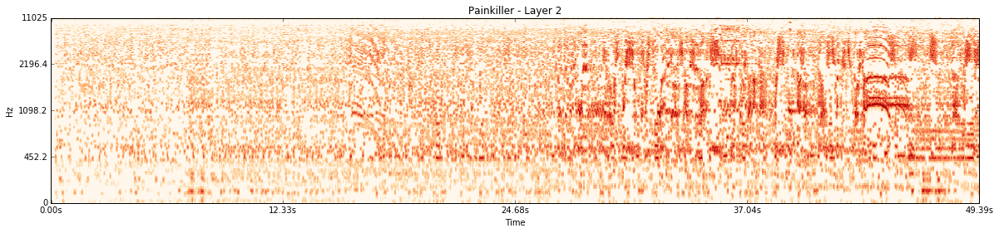

In [97]:
layers, boundaries, audio_stft = extract_all_layers('demo_songs/painkiller.wav')
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    sample_start = boundary_samples[i]
    if i == 2:
        l = layers[i]
        for k in range(i+1, len(layers)):
            l += layers[k]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'Painkiller - Layer ' + str(i))
    if i == 2:
        break

## Evaluation

We evaluated our method for segmentation and separation accuracy on a constructed dataset using audio loops from [Looperman](http://www.looperman.com).

We collected 15 of these audio loops, each 8 seconds long.

Set A contained 5 loops of rhythmic material, set B contained 5 loops of harmonic and rhythmic material, and set C contained 5 loops of piano. There are 125 mixtures, constructed as follows:

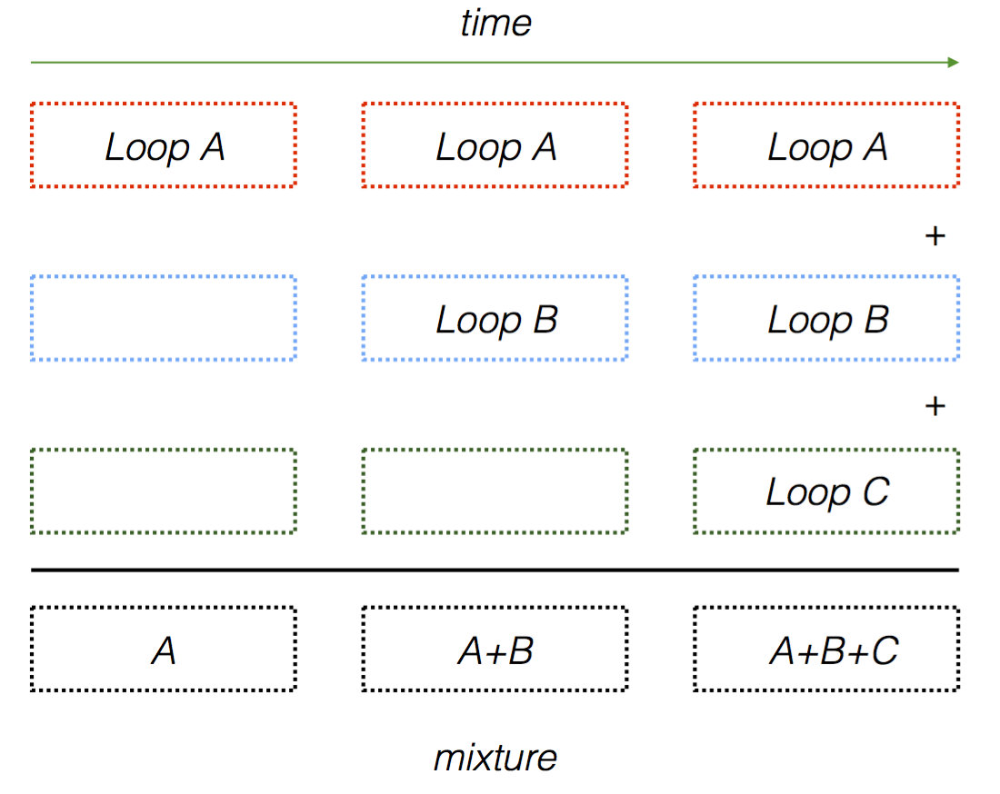

In [79]:
show_figure('figures/loop.png', 350)

Here's the algorithm running on one such mixture:

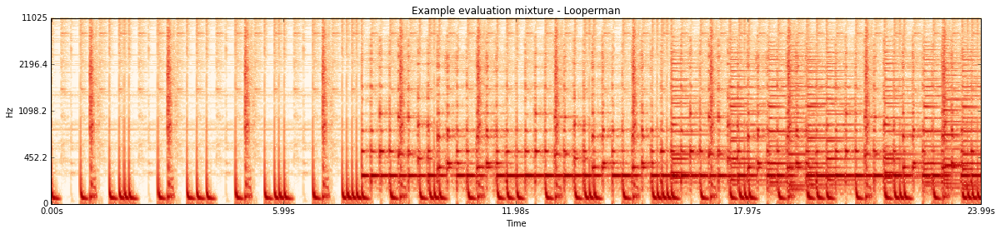

Going from beat 0 to 20
LAYER: 1
Going from beat 20 to 42
LAYER: 2
Going from beat 42 to 57
LAYER: 3
Residual rms too low, terminating


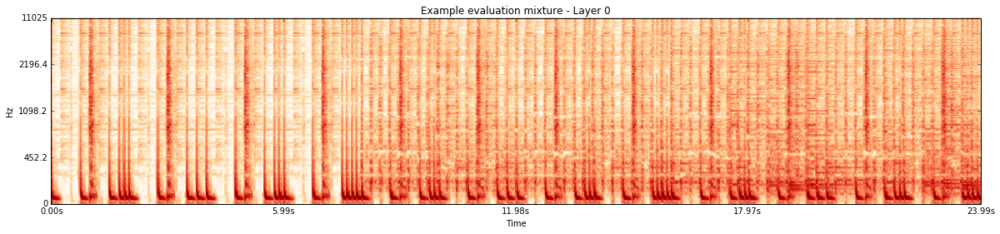

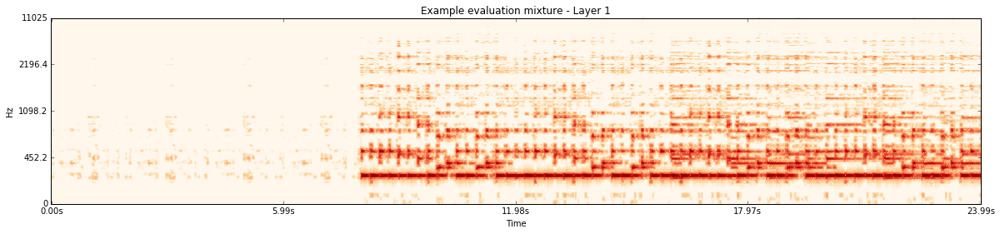

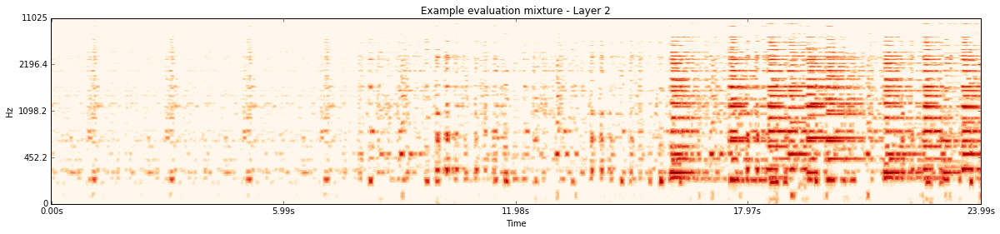

In [96]:
load_and_display('demo_songs/evaluation_mixture.wav', 'Example evaluation mixture - Looperman')
layers, boundaries, audio_stft = extract_all_layers('demo_songs/evaluation_mixture.wav')
boundary_samples = np.insert(librosa.frames_to_samples(boundaries), 0, 0)
for i, l in enumerate(layers):
    sample_start = boundary_samples[i]
    display_spectrogram_and_audio(librosa.stft(l), l[sample_start:], sr, 'Example evaluation mixture - Layer ' + str(i))

The algorithm has to simultaneously find the segmentation points using the beat-synchronous reconstruction error feature and separate the associated sources from the mixture. We can compare our performance to existing source separation and music segmentation algorithms. 

For segmentation, we compare to three algorithims, packaged in MSAF [3]:

1. Convex non-negative matrix factorization on the self-similarity matrix. [4]
2. Structural features [5]
3. Foote novelty curve [6]

We use median deviation from estimated and ground truth boundaries to determine the performance of the different approaches. Our results for segmentation accuracy are:

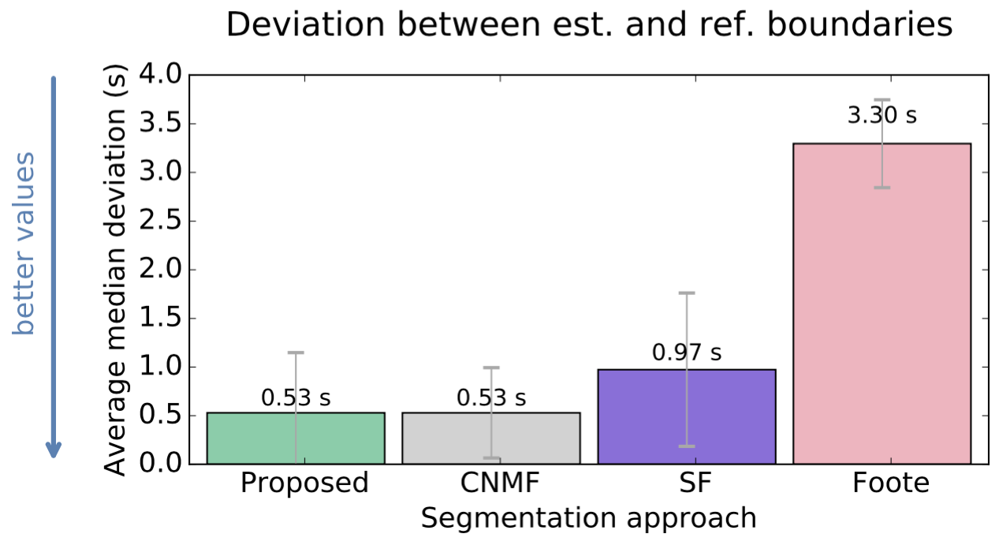

In [81]:
show_figure('figures/segmentation_results.png', 500)

| Approach                | Median deviation (s) | Number of segments found |
|-------------------------|----------------------|--------------------------|
| Convex NMF [4]          | $.53$                  | $6.152$                    |
| Structural features[5]  | $.97$                  | $4.024$                    |
| Foote novelty curve [6] | $3.3$                  | $3.048$                    |
| Proposed                | $.53$                  | $3.216$                    |

We find that our approach is as accurate at finding boundaries as existing segmentation methods, while finding closer to the ground truth number of boundaries.

For separation, we compare to an MFCC-based clustering of an unguided NMF [7] on the entire mixture with 24 spectral templates and 100 spectral templates. We use Source to Distortion Ratio (SDR), Source to Interference Ratio (SIR) and Source to Artifact Ratio (SAR) to compare methods. We also compare to an ideal binary mask, which is the best our method could possibly do. Our results for separation quality are:

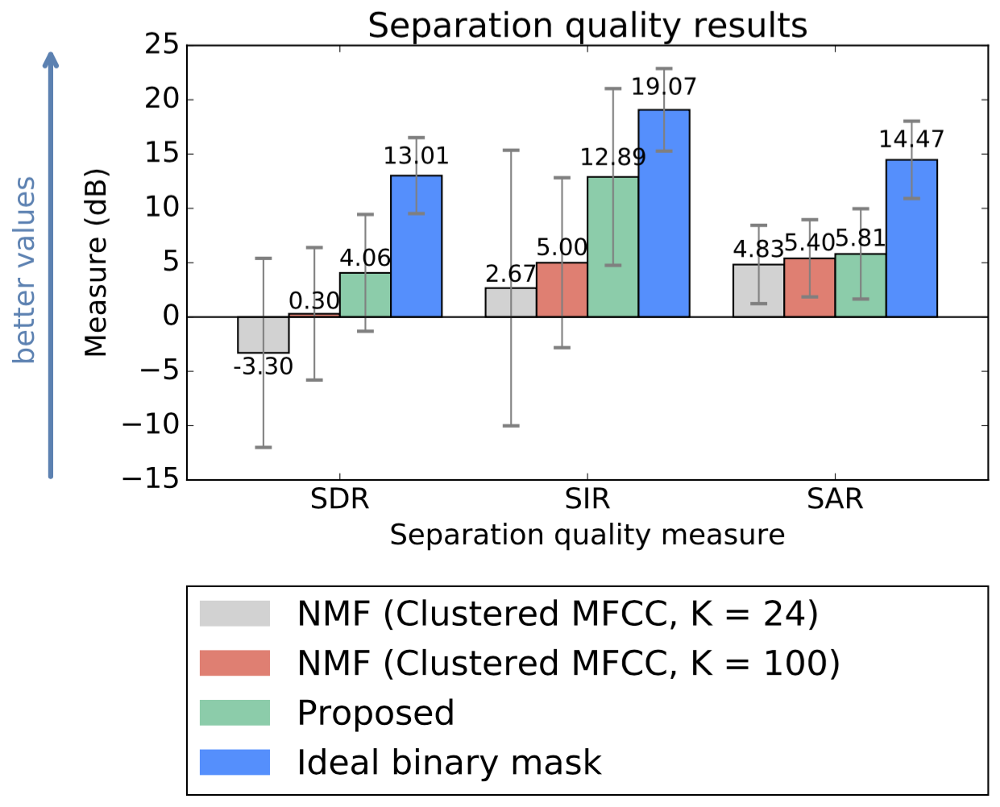

In [82]:
show_figure('figures/separation_results.png', 500)

## References

> [1] Fitzgerald, Derry. “Harmonic/percussive separation using median filtering.” 13th International Conference on Digital Audio Effects (DAFX10), Graz, Austria, 2010.

> [2] Ellis, Daniel PW. “Beat tracking by dynamic programming.” Journal of New Music Research 36.1 (2007): 51-60. http://labrosa.ee.columbia.edu/projects/beattrack/

> [3] Nieto, O., Bello, J. P., Systematic Exploration Of Computational Music Structure Research. Proc. of the 17th International Society for Music Information Retrieval Conference (ISMIR). New York City, NY, USA, 2016

> [4] Nieto, Oriol, and Tristan Jehan. "Convex non-negative matrix factorization for automatic music structure identification." 2013 IEEE International Conference on Acoustics, Speech and Signal Processing. IEEE, 2013.
 
> [5] Serra, Joan, Meinard Müller, and Peter Grosche. "Unsupervised detection of music boundaries by time series structure features." Proceedings of the Twenty-Sixth AAAI Conference on Artificial Intelligence. AAAI Press, 2012.

> [6] Foote, Jonathan. "Automatic audio segmentation using a measure of audio novelty." Multimedia and Expo, 2000. ICME 2000. 2000 IEEE International Conference on. Vol. 1. IEEE, 2000.

> [7] Spiertz, Martin, and Volker Gnann. "Source-filter based clustering for monaural blind source separation." Proceedings of the 12th International Conference on Digital Audio Effects. 2009.


## Utilities

In [83]:
import IPython
from IPython.display import Image
import random
import string
import ffmpy
import os

def show_figure(fig_path, width):
    IPython.display.display(Image(fig_path, width = width))

def load_and_display(audio_path, title):
    audio_signal, sr, audio_stft = load_file(audio_path)
    display_spectrogram_and_audio(audio_stft, audio_signal, sr, title)

def display_spectrogram(stft, title, x_axis, y_axis, beats=None):
    plt.figure(figsize=(20, 4))
    librosa.display.specshow(librosa.logamplitude(np.abs(stft)**2, ref_power = np.max), y_axis = y_axis, x_axis = x_axis)
    plt.title(title)
    if beats is not None:
        plt.vlines(beats, 0, 1025, linestyles='dashed')
    plt.show()
    
def display_spectrogram_and_audio(stft, audio_signal, sr, title):
    display_spectrogram(stft, title, 'time', 'log')
    audio(audio_signal, sr)

def disp_audio(layers):
    for i, l in enumerate(layers):
        print 'Layer:' + str(i)
        audio(l, 22050)
        
def audio(d, sr):
    tmp_file = 'tmp.mp3'
    file_path = 'tmp.wav'
    librosa.output.write_wav('tmp.wav', d, sr)
    ff = ffmpy.FFmpeg(
        inputs={file_path: None},
        outputs={tmp_file: None})
    ff.run()
    IPython.display.display(IPython.display.Audio(tmp_file))
    os.remove('tmp.mp3')
    os.remove('tmp.wav')
    
def show_errors(errors, beats, title):
    plt.figure(figsize=(20, 4))
    plt.title(title)
    errors = [0 for i in range(0, len(beats)-len(errors))] + errors
    errors = np.array(errors)/np.max(errors)
    plt.step(beats, errors)
    plt.xlabel('Time (beats)')
    plt.xticks(beats[::10], range(0, len(beats))[::10])
    plt.xlim(0, template.shape[1])
    plt.ylim(min(errors), max(errors))
    plt.vlines(beats, min(errors), max(errors), linestyles='dashed')
    plt.ylabel('Reconstruction error')
    
from IPython.core.display import HTML
HTML("""
<style>
audio {
    width: 100%;
}
.output_png {
    text-align: center;
}
</style>
""")